In [1]:
!cp -r /content/drive/MyDrive/DL/datasets /content
!cp -r /content/drive/MyDrive/DL/models /content
!sudo apt-get install unzip
!unzip -q /content/datasets/blueberry_classification/data.zip -d /content/datasets/blueberry_classification

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
unzip is already the newest version (6.0-26ubuntu3.2).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [2]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
from torchvision import transforms
from models.unet_diffusion_conditional import SimpleUnet
from torch.optim import Adam


from torch.utils.data import Dataset, DataLoader
import os
import pandas as pd
from torchvision import transforms
from PIL import Image
from datasets.blueberry_classification.dataloader import CustomImageDataset

import gc
from tqdm import tqdm


plt.rcParams['text.usetex'] = False
plt.rcParams['savefig.dpi'] = 100
plt.rcParams["figure.dpi"] = 100

device = "cuda" if torch.cuda.is_available() else "cpu"

print(device)

cuda


In [3]:
def clean_gpu():
    for i in range(10):
        torch.cuda.empty_cache()
        gc.collect()

def tensor2image(tensor):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    return reverse_transforms(tensor)

def image2tensor(image):
    image2tensor_transformation = transforms.Compose([
            transforms.Resize(size = (224,224)),
            transforms.ToTensor(),
            transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ])

    return image2tensor_transformation(image)


def plot_gallery(images_list, title):
    fig, axs = plt.subplots(1, len(images_list), figsize=(20, 2))
    for idx, xt in enumerate(images_list):
        # axs[idx].set_title(r'$x_{t}$'.replace("t",f"{idx}"))
        axs[idx].imshow(tensor2image(xt.cpu()))

    fig.suptitle(title)
    fig.tight_layout()

# Implementing training and sampling from paper
def train(batch, optimizer, model, device):
    global alpha_hat, alpha, T
    images, categories = batch

    bs = images.shape[0]
    timesteps = torch.randint(0, T, (bs,), device=device, dtype=torch.int64)
    noise = torch.randn_like(images, device=device)
    alpha_hat_t = alpha_hat[timesteps][...,None, None, None]
    noisy_images = torch.sqrt(alpha_hat_t)*images + torch.sqrt(1 - alpha_hat_t)*noise


    noise_pred = model(noisy_images, timesteps, categories)

    loss = F.mse_loss(noise_pred, noise)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    return model, loss

def sampling(model, batch, category, T, device):
    global alpha_hat, alpha

    every_step = T//10

    t_list = torch.arange(T)[...,None].to(device)
    denoising_results = []

    noise = torch.randn_like(batch)
    xt = torch.sqrt(alpha_hat[T-1])*batch + torch.sqrt(1 - alpha_hat[T-1])*noise

    for idx, t in enumerate(reversed(t_list)):

        with torch.no_grad():
            xt = 1/(torch.sqrt(alpha[t])) * (xt - model(xt, t, category)*(1 - alpha[t])/torch.sqrt(1 - alpha_hat[t])) #+ sigma[t]*random

        if idx % every_step == 0:
            denoising_results.append(xt[0])
    return denoising_results

In [20]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Lambda(lambda t: (t * 2) - 1)
])

target_transform = {
    'azul': 0,
    'cremoso': 1,
    'pinton1': 2,
    'pinton2': 3,
    'rosado': 4,
    'verde': 5
}

dataset = CustomImageDataset(annotations_file='annotations.csv',
                             img_dir='/content/datasets/blueberry_classification',
                             transform=transform,
                             target_transform=target_transform )

batch_size = 20
shuffle = True
num_workers = 2  # Number of subprocesses to use for data loading
data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle, num_workers=num_workers)

In [5]:
T = 200
num_epochs = 50
steps_per_epoch = 100

scheduler = lambda timesteps: torch.linspace(start=0.0001, end=0.02, steps=timesteps)
beta = scheduler(T).to(device)
alpha = (1 - beta).to(device)
alpha_hat = torch.cumprod(alpha, axis=0).to(device)
every_step = T // 10

In [21]:
model = SimpleUnet().to(device)
optimizer = Adam(model.parameters(), lr=0.001)

def train():
    global data_loader, model, device, alpha_hat

    clean_gpu()
    for batch in tqdm(data_loader):
        images, labels = batch[0].to(device), batch[1].to(device)

        # forward
        bs = images.shape[0]
        timesteps = torch.randint(0, T, (bs,), device=device, dtype=torch.int64)
        noise = torch.randn_like(images, device=device)
        alpha_hat_t = alpha_hat[timesteps][...,None, None, None]
        noisy_images = torch.sqrt(alpha_hat_t)*images + torch.sqrt(1 - alpha_hat_t)*noise


        noise_pred = model(noisy_images, timesteps, labels)
        loss = F.mse_loss(noise_pred, noise)
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    return model, loss

100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


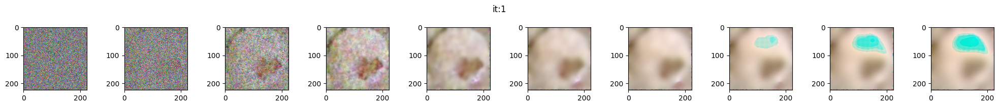

category: pinton1


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


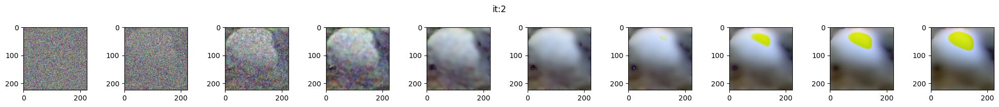

category: azul


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


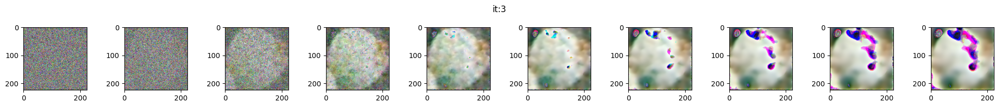

category: verde


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


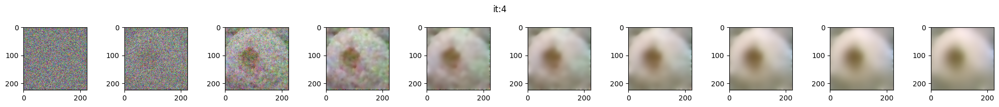

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


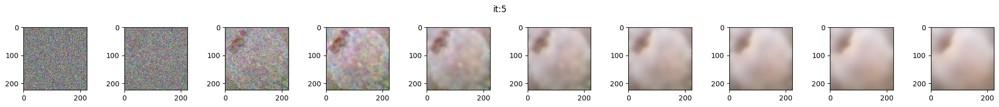

category: pinton1


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


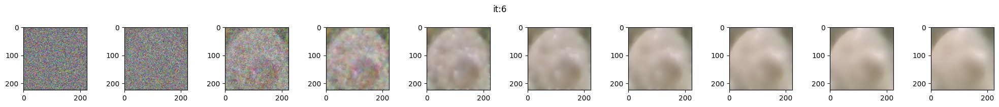

category: pinton1


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


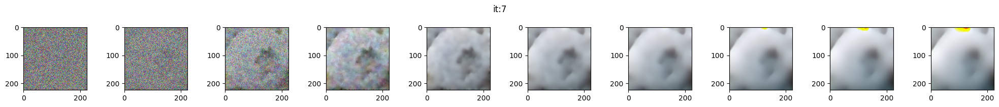

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


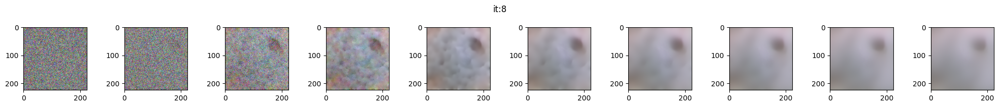

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


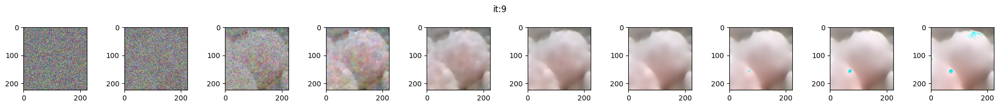

category: pinton1


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


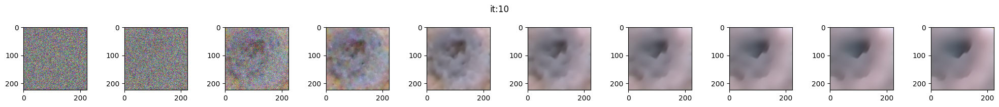

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


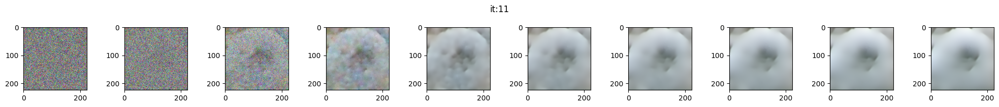

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


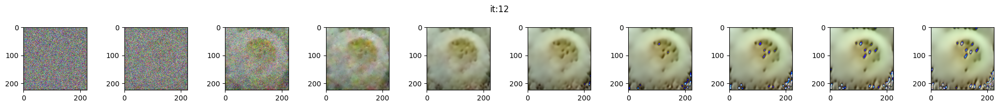

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


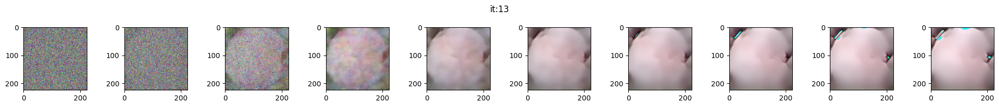

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


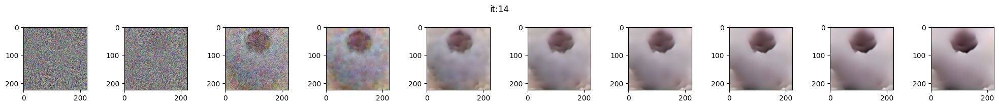

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


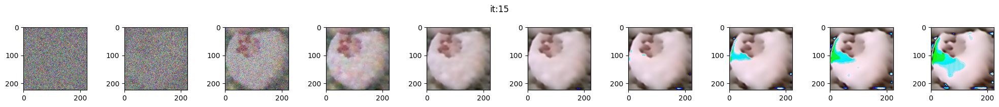

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


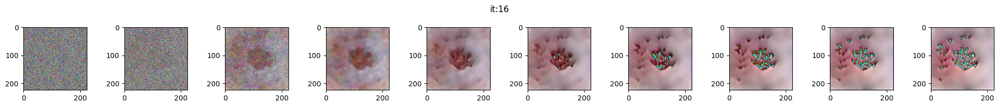

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


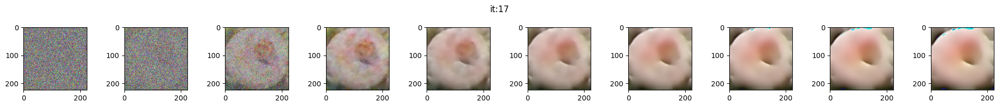

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


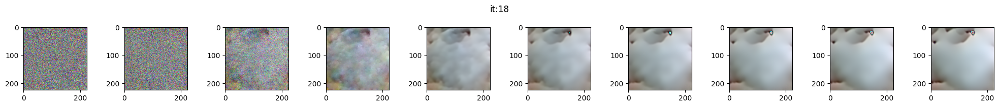

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


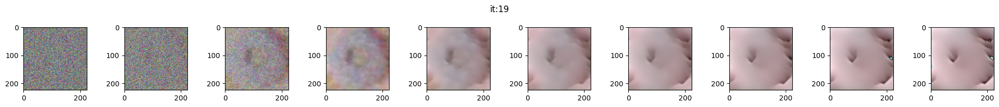

category: pinton2


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


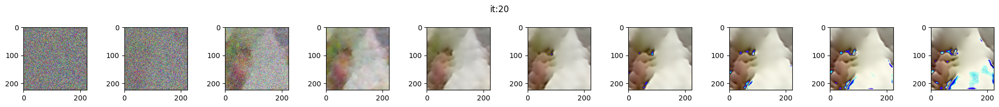

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


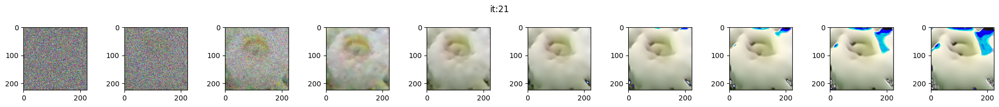

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


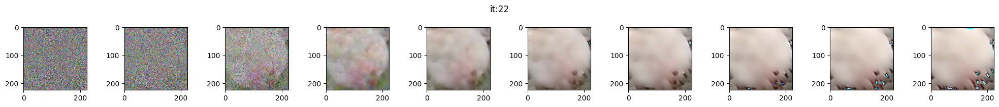

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


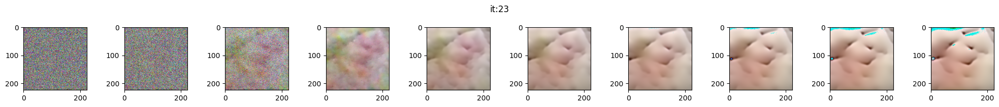

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


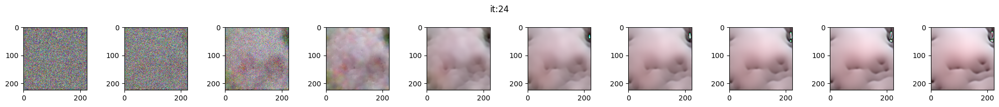

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


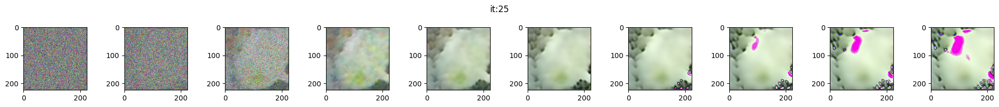

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


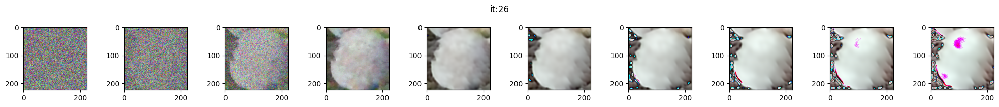

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


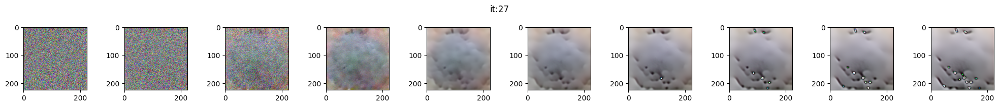

category: azul


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


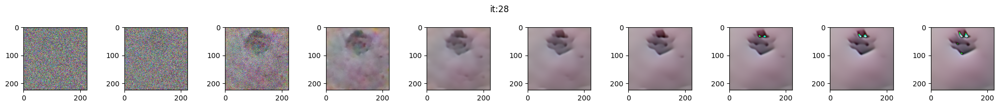

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


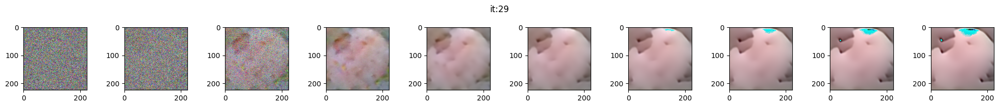

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


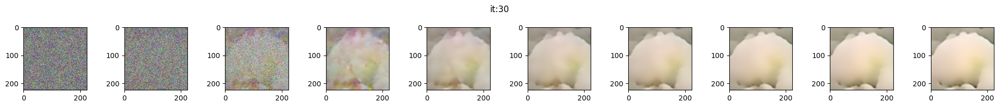

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


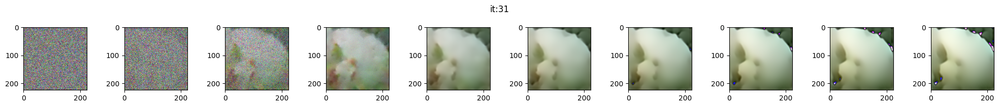

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


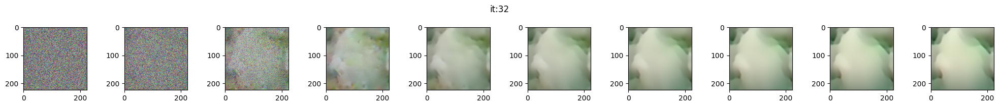

category: verde


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


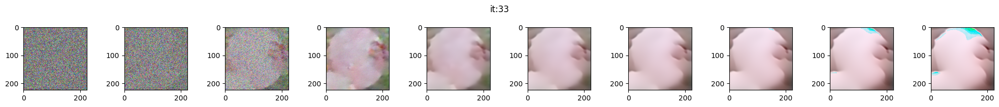

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


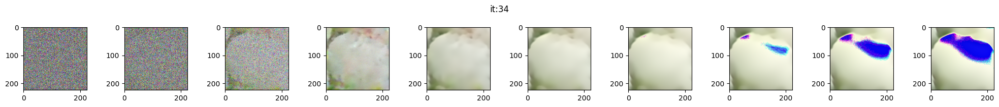

category: verde


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


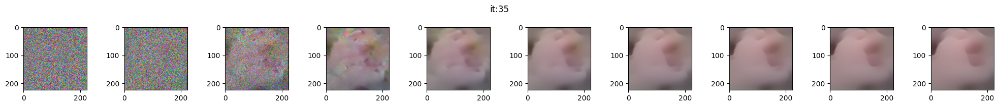

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


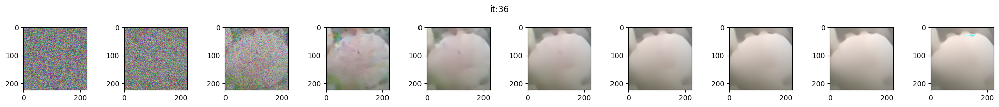

category: pinton1


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


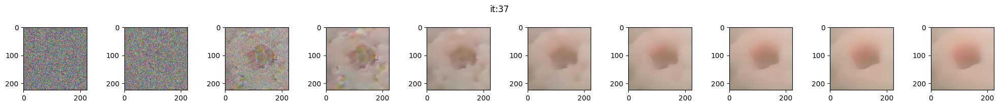

category: cremoso


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


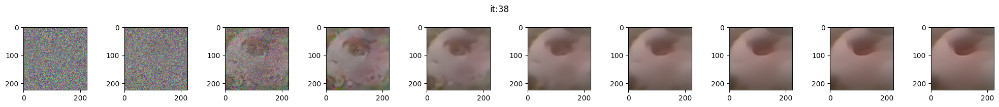

category: pinton2


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


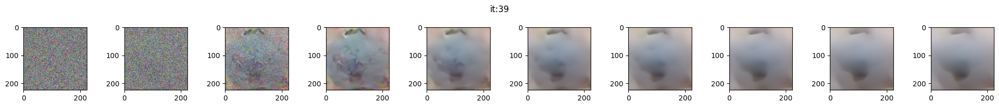

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


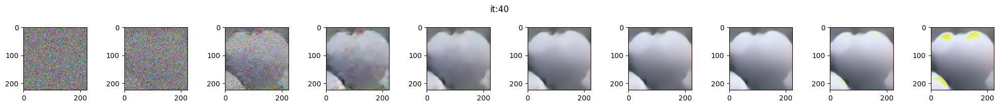

category: rosado


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


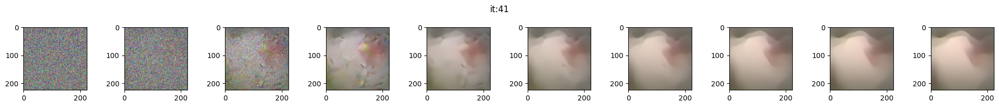

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


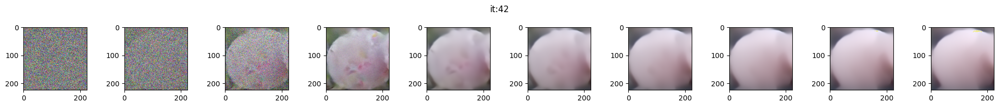

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


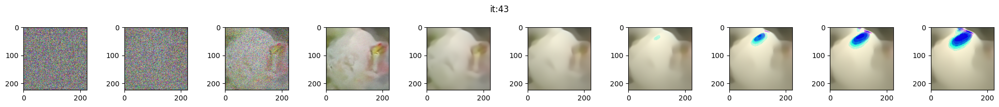

category: verde


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


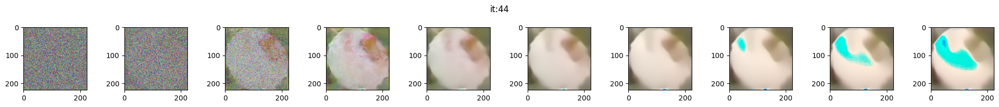

category: cremoso


100%|██████████| 76/76 [02:06<00:00,  1.66s/it]


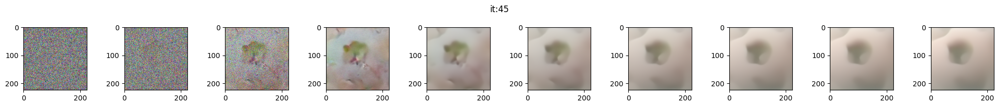

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


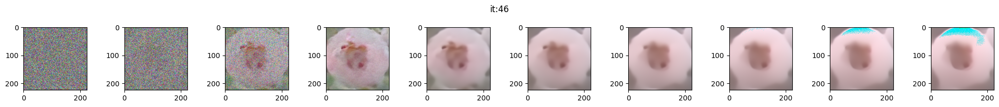

category: pinton1


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


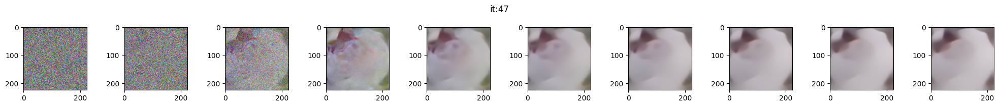

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


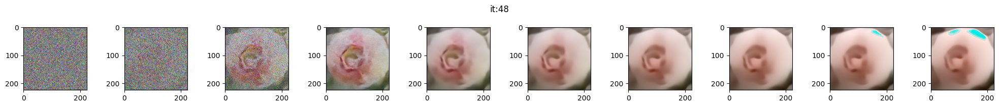

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


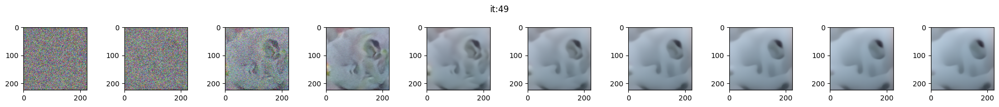

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.65s/it]


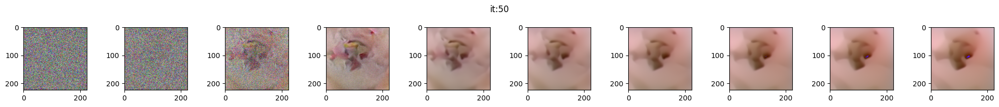

category: rosado


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


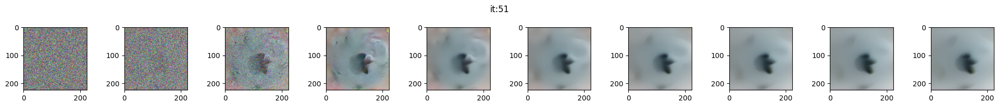

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


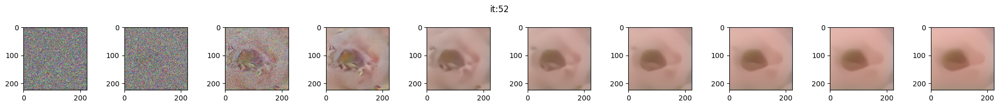

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


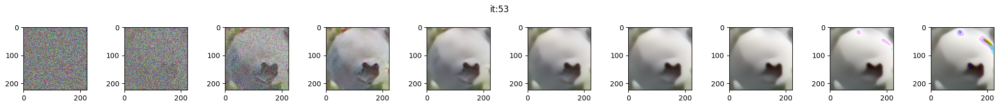

category: azul


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]


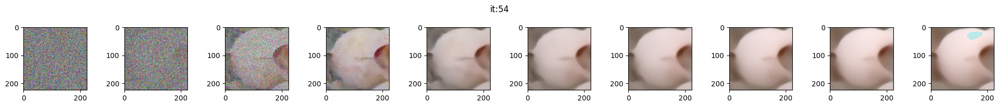

category: cremoso


100%|██████████| 76/76 [02:05<00:00,  1.66s/it]
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7e92d3775630>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1443, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.10/multiprocessing/process.py", line 149, in join
    res = self._popen.wait(timeout)
  File "/usr/lib/python3.10/multiprocessing/popen_fork.py", line 40, in wait
    if not wait([self.sentinel], timeout):
  File "/usr/lib/python3.10/multiprocessing/connection.py", line 931, in wait
    ready = selector.select(timeout)
  File "/usr/lib/python3.10/selectors.py", line 416, in select
    fd_event_list = self._selector.poll(timeout)
KeyboardInterrupt: 


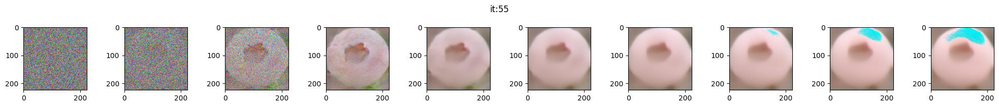

category: pinton2


  5%|▌         | 4/76 [00:06<02:03,  1.72s/it]


KeyboardInterrupt: 

In [25]:
for i in range(100):
  model, loss = train()

  image, label = next(iter(data_loader))
  results = sampling(model, image[0][None,...].to(device), label[0][None,...].to(device), T, device)
  plot_gallery(results,f"it:{i+1}")
  plt.show()
  print('category:',list(target_transform.keys())[list(target_transform.values()).index(label[0].item())])

In [26]:
torch.save(model,'weights.pt')
!cp /content/weights.pt /content/drive/MyDrive/DL

In [27]:
torch.save(model.state_dict(), 'weights_state_dict.pt')
!cp /content/weights_state_dict.pt /content/drive/MyDrive/DL